In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pyfits as fits
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
filename = 'muse_scipost_N_SN2009bb_DATACUBE_FINAL_IFU_001_zap.fits'
filepath = 'data/'

In [3]:
data = fits.open(filepath+filename)

In [4]:
image = data[1].data
header = data[1].header
del data

In [5]:
image.shape

(3681, 321, 320)

#### Building the spectra of the image

In [25]:
# spectral wavelengths
CRVAL3 = float(header["CRVAL3"])
CRPIX3 = float(header["CRPIX3"])
CUNIT3 = header["CUNIT3"]
CD31 = float(header["CD3_1"])
CD32 = float(header["CD3_2"])
CD33 = float(header["CD3_3"])
NAXIS3 = int(header["NAXIS3"])
lambdas = np.array(CRVAL3 + CD33 * (np.arange(NAXIS3) - CRPIX3))

In [26]:
image_spec = image[:, 100:300, 20:220]
spectra = np.sum(image_spec, axis=(1, 2))

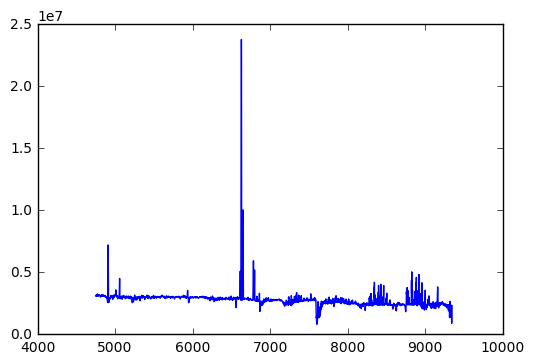

In [27]:
plt.plot(lambdas, spectra)

#### Animation of progression of the spectrum

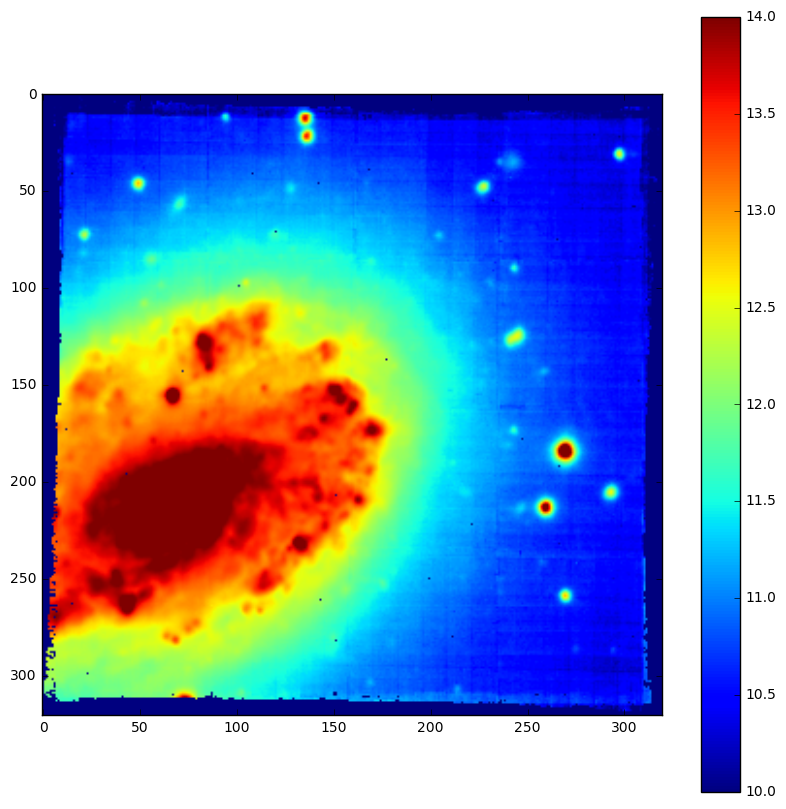

In [6]:
image2D = np.sum(image, axis=0)
image2D[np.invert(np.isfinite(image2D))] = 0
image2D = np.arcsinh(image2D)
fig, ax = plt.subplots(figsize = (10, 10))
color = ax.imshow(image2D, clim = (10, 14));
fig.colorbar(color);

In [7]:
from tempfile import NamedTemporaryFile

VIDEO_TAG = """<video controls>
 <source src="data:video/x-m4v;base64,{0}" type="video/mp4">
 Your browser does not support the video tag.
</video>"""

def anim_to_html(anim):
    if not hasattr(anim, '_encoded_video'):
        with NamedTemporaryFile(suffix='.mp4') as f:
            anim.save(f.name, fps=20, extra_args=['-vcodec', 'libx264'])
            video = open(f.name, "rb").read()
        anim._encoded_video = video.encode("base64")
    
    return VIDEO_TAG.format(anim._encoded_video)

In [8]:
from IPython.display import HTML

def display_animation(anim):
    plt.close(anim._fig)
    return HTML(anim_to_html(anim))

In [120]:
fig, ax = plt.subplots(figsize = (7, 7))
im = ax.imshow(image2D);
bias = 0
x_val = 300
y_val = 30
text_obj = ax.text(x_val, y_val, lambdas[bias], va='center', ha='center', color='w')
def updatefig(j):
     # set the data in the axesimage object
    image2D = image[bias + j, :, :]
    image2D[np.invert(np.isfinite(image2D))] = 0
    image2D = np.arcsinh(image2D)
    im.set_array(image2D)
    text_obj.set_text(lambdas[bias+j])
    # return the artists set
    return im, text_obj,
anim = animation.FuncAnimation(fig, updatefig,
                               frames=250, interval=200, blit=True)
anim.save('oxygen.mp4', fps=10, dpi=800)
display_animation(anim)

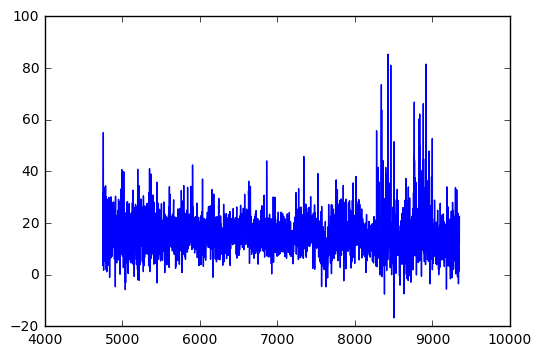

In [48]:
plt.plot(lambdas, image_spec[:, 150, 150])

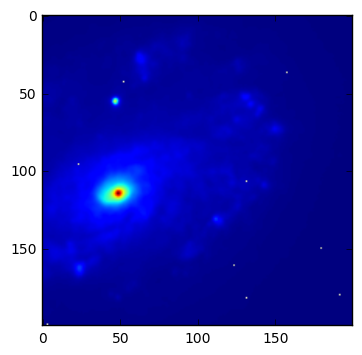

In [45]:
plt.imshow(np.sum(image_spec, axis=0))

#### Analysis

#### Notes
6640.976[1514] is where the difference starts showing up.

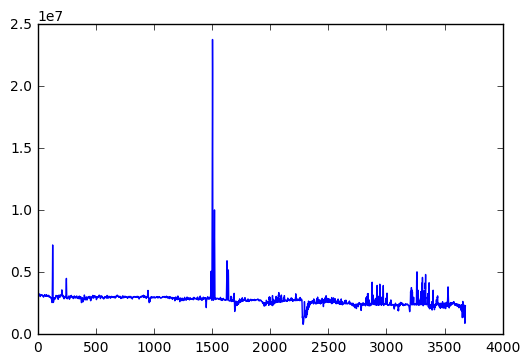

In [119]:
plt.plot(range(len(spectra)), spectra)

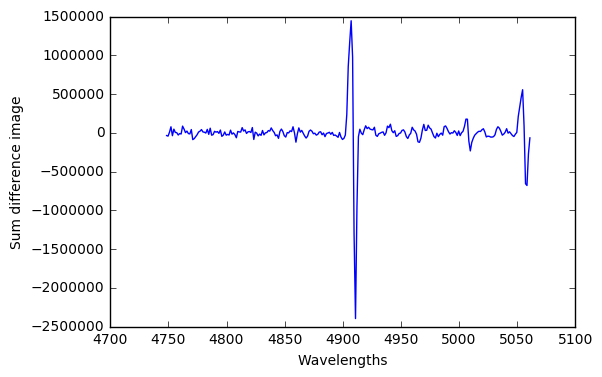

In [121]:
arg_j_start = 0
arg_j_end = 250
sum_values = []
for i in range(arg_j_start, arg_j_end+1):
    sum_values.append(sum(image[i+1, :, :] - image[i, :, :]))
plt.plot(lambdas[arg_j_start: arg_j_end+1], sum_values)
plt.xlabel('Wavelengths')
plt.ylabel('Sum difference image')

6648.47607422


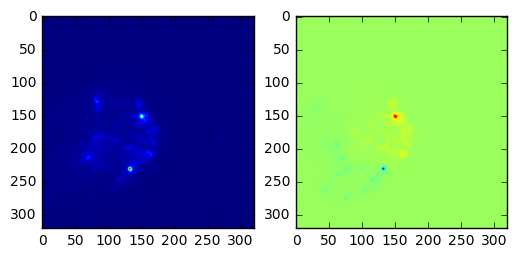

In [122]:
arg_j =1520
print lambdas[arg_j]
fig, ax = plt.subplots(nrows=1, ncols=2)
ax[0].imshow(image[arg_j+1, :, :])
ax[1].imshow(image[arg_j+1, :, :] - image[arg_j, :, :])